Before we begin, it’s important to ensure that our datasets are organized
so that Python tools can easily interact with them.

We have several folders containing cultivation data for two marine
microalgae species: PT and NO. The cultivation data is stored in .xlsx files,
which are structured for easy reading with the Python library "pandas".

All .xlsx files begin with the same 10 columns of observation IDs,
which serve as a (potential) pandas multi-index.

- monitordata.xlsx contains key monitoring variables measured using standard
  analytical methods, for example:
    - Cell concentration, CC (M/mL)
    - Single-cell autofluorescence, CytoRed (a.u.)
    - Single-cell size, CytoFSC (a.u.)
    - Total content of the main characteristic carotenoid:
      - Fucoxanthin, Fx (ppm) for PT
      - Violaxanthin, Vx (ppm) for NO
    - etc.\n
    
- absdata.xlsx contains absorbance measurements at 500 wavelengths (300–800 nm).
- fluorodata.xlsx contains fluorescence intensity measurements at 6103 
  excitation-emission wavelength pairs (250/260–790/800 nm).

Let’s use pandas to open these files.


In [1]:
#  Opening the datasets

import pandas as pd

# Specify the folder name
folder = 'C:/Users/pedro.brandao/OneDrive - iBET/Desktop/Datasets and scripts updated/NO Dataset'

# Import monitor data (measurements using standard analytical methods)
monitordata = pd.read_excel(folder + '/monitordata.xlsx')

# Lets get the info about a sample (e.g. 25th row)
sample_number = 25
monitordata.iloc[sample_number]

Obs_ID                                         NOAx2_02_5
Assay_ori                                       NO Axenic
Assay                                  F2+N+P (F2+N-inoc)
Assay_ID                                            NOAx2
Batch_ID                                         NOAx2_02
Obs_ID2                                              Ax_5
Year                                                 2024
Date                                  2024-01-25 00:00:00
Date 2                                2024-01-25 00:00:00
Day                                                     5
Day 2                                                   3
Peptone added                                           0
Culture state                            2 - Intermediate
Culture trend                               2 - Expanding
CC (million cells/mL)                           39.718932
CytoRed (a.u.)                                      75.17
CytoFSC (a.u.)                                     109.32
CytoNR (a.u.) 

In [2]:
# Let's take a look at the spectroscopy data

# Import absdata and fluorodata (measurements using spectroscopy methods)


fluorodata, absdata = (
    pd.read_excel(folder + '/fluorodata.xlsx'),
    pd.read_excel(folder + '/absdata.xlsx')
)

# Note: This may take some time, as the files are large!

fluorodata

,Obs_ID,Assay_ori,Assay,Assay_ID,Batch_ID,Obs_ID2,Year,Date,Date 2,Day,...,EEP 775 / 800 nm,EEP 780 / 785 nm,EEP 780 / 790 nm,EEP 780 / 795 nm,EEP 780 / 800 nm,EEP 785 / 790 nm,EEP 785 / 795 nm,EEP 785 / 800 nm,EEP 790 / 795 nm,EEP 790 / 800 nm
0,NOAx2_01_1,NO Axenic,F2+N+P (F2+N-inoc),NOAx2,NOAx2_01,Ax_1,2024,2024-01-21,2024-01-21,1,...,95.602295,1000.0,1000.0,1000.000000,380.294647,1000.0,1000.0,1000.000000,1000.0,1000.0
1,NOAx2_02_1,NO Axenic,F2+N+P (F2+N-inoc),NOAx2,NOAx2_02,Ax_1,2024,2024-01-21,2024-01-21,1,...,83.556747,1000.0,1000.0,1000.000000,431.334625,1000.0,1000.0,1000.000000,1000.0,1000.0
2,NOAx2_03_1,NO Axenic,F2+N+P (F2+N-inoc),NOAx2,NOAx2_03,Ax_1,2024,2024-01-21,2024-01-21,1,...,78.691422,1000.0,1000.0,1000.000000,352.914978,1000.0,1000.0,1000.000000,1000.0,1000.0
3,NOAx2_04_1,NO Axenic,F2+N+P (F2+N-inoc),NOAx2,NOAx2_04,Ax_1,2024,2024-01-21,2024-01-21,1,...,60.147121,1000.0,1000.0,843.692017,309.004761,1000.0,1000.0,853.456665,1000.0,1000.0
4,NOAx2_05_1,NO Axenic,F2+N+P (F2+N-inoc),NOAx2,NOAx2_05,Ax_1,2024,2024-01-21,2024-01-21,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,NOAx4_08_20,NO Axenic,F2+N (F2-inoc),NOAx4,NOAx4_08,Ax_20,2024,2024-07-19,2024-07-19,20,...,459.395660,1000.0,1000.0,1000.000000,1000.000000,1000.0,1000.0,1000.000000,1000.0,1000.0
266,NOAx4_09_20,NO Axenic,F2+N (F2-inoc),NOAx4,NOAx4_09,Ax_20,2024,2024-07-19,2024-07-19,20,...,554.523254,1000.0,1000.0,1000.000000,1000.000000,1000.0,1000.0,1000.000000,1000.0,1000.0
267,NOAx4_10_20,NO Axenic,F2+N+P (F2-inoc),NOAx4,NOAx4_10,Ax_20,2024,2024-07-19,2024-07-19,20,...,850.374023,1000.0,1000.0,1000.000000,1000.000000,1000.0,1000.0,1000.000000,1000.0,1000.0
268,NOAx4_11_20,NO Axenic,F2+N+P (F2-inoc),NOAx4,NOAx4_11,Ax_20,2024,2024-07-19,2024-07-19,20,...,828.263916,1000.0,1000.0,1000.000000,1000.000000,1000.0,1000.0,1000.000000,1000.0,1000.0


To improve loading speed, we should convert the .xlsx files to .pkl,
a much faster format for reading and writing data.

This way, future loads will be significantly quicker. We'll create new files, but this takes some time also

In [3]:
# Convert data to pickle

monitordata.to_pickle('monitordata.pkl')
absdata.to_pickle('absdata.pkl')
fluorodata.to_pickle('fluorodata.pkl')


In [4]:
# Let's delete the data (variables) from our python environment
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In the next cell we load again the data; you'll notice the loading time will be almost instantaneous...

In [5]:
# Load data from pickle files

import pandas as pd
monitordata, fluorodata, absdata = (
    pd.read_pickle('monitordata.pkl'),
    pd.read_pickle('fluorodata.pkl'),
    pd.read_pickle('absdata.pkl')
)


Next, we need to distinguish between index information and the actual data.

There are 14 columns containing index information; let's collect the names
of these columns and store them in a variable called "sampleinfo".

In [6]:
# Identifying indexes within the data

IDcolumns_number = 14

# Collect the first 14 column names as index identifiers
sampleinfo = list(monitordata.columns[:IDcolumns_number])

print('\nThe index information includes:\n')
for item in sampleinfo:
    print(item)


The index information includes:

Obs_ID
Assay_ori
Assay
Assay_ID
Batch_ID
Obs_ID2
Year
Date
Date 2
Day
Day 2
Peptone added
Culture state
Culture trend


Following the same logic, all columns beyond the first 14 are either
monitoring parameter data or spectral data.

In [7]:
# Identifying the variables: monitor parameters and spectroscopy wavelengths

# Collect column names for monitoring variables and spectral data
monitor_params = list(monitordata.columns[IDcolumns_number:])
abswaves = list(absdata.columns[IDcolumns_number:])
fluorowaves = list(fluorodata.columns[IDcolumns_number:])

print('\nThe monitoring parameters are:\n')
for item in monitor_params:
    print(item)
   
print('\nThe absorbance wavelengths range from: {} to {}'.format(abswaves[0], abswaves[-1]))

print('\nThe fluorescence excitation-emission pairs (EEP) of wavelengths range from: {} to {}'.format(
    fluorowaves[0], fluorowaves[-1]))


The monitoring parameters are:

CC (million cells/mL)
CytoRed (a.u.)
CytoFSC (a.u.)
CytoNR (a.u.)
Lipidic cells (%)
Vx (ppm) - HPLC
Fx (ppm) - HPLC
Fx (ppm)
Vx (ppm)
High Lipid population (%)
High Photosynthesis population (%)
Lipids (ppm)
MUSE Lipids
log CFU
Viability (%)

The absorbance wavelengths range from: Abs at 300 nm to Abs at 799 nm

The fluorescence excitation-emission pairs (EEP) of wavelengths range from: EEP 250 / 260 nm to EEP 790 / 800 nm


Now, we ensure that every observation of absorbance, fluorescence,
or monitoring parameter has the same index (i.e., the index will be sampleinfo).

In [8]:
# Set index permanently and select assays of interest

monitordata = monitordata.set_index(sampleinfo)
absdata = absdata.set_index(sampleinfo)
fluorodata = fluorodata.set_index(sampleinfo)

The monitor parameters are the quantities we want to predict from using spectroscopy.
They are the 'outputs' of a model that uses spectral data as inputs.

First, we'll plot both the outputs and selected spectral inputs to visually confirm
that the data imported from the Excel files is correct.

C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 37.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 26.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 7.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn

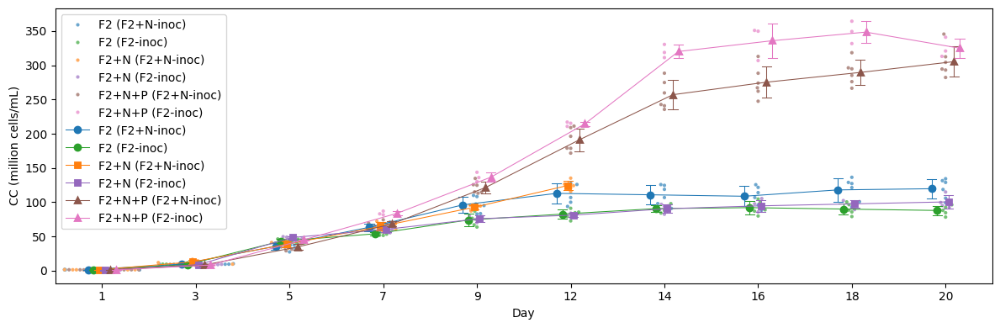

C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 28.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 32.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 14.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\pedro.brandao\Documents\Python env\virtual_env\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 16.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.war

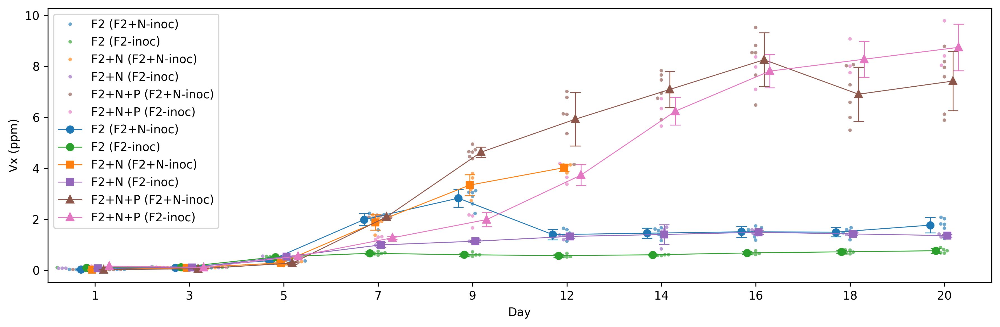

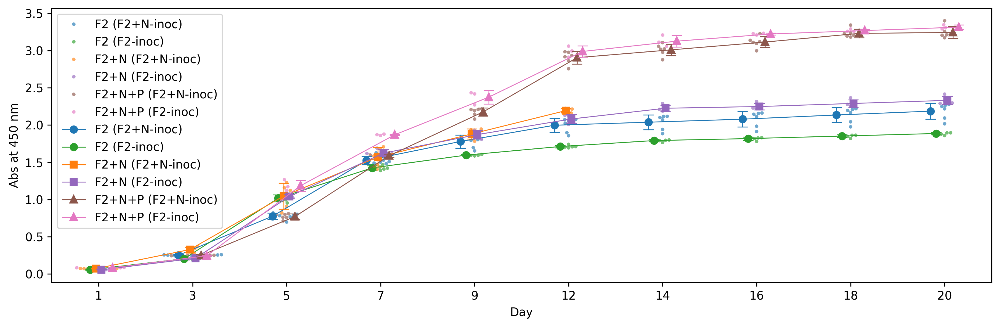

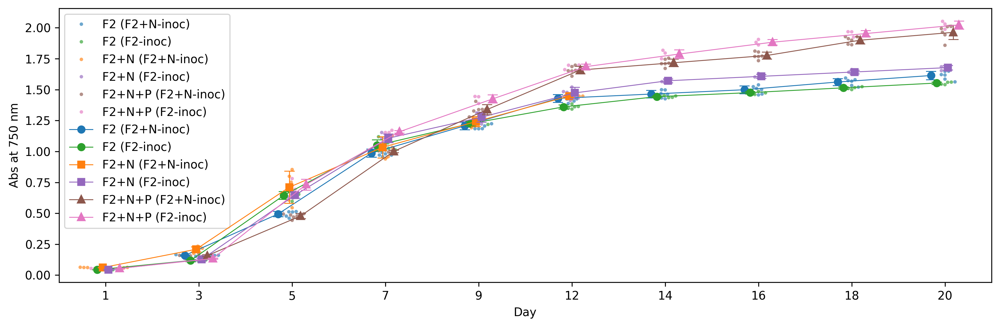

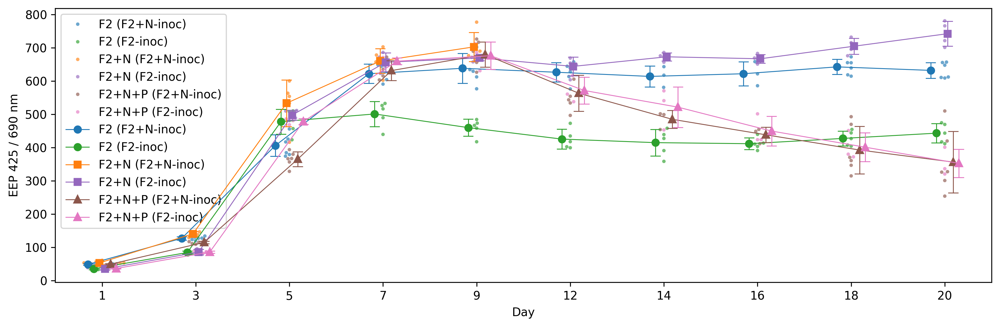

In [9]:
# Plot monitor parameters (outputs)

# Import the plotting function
from output_plotter import plot_output_timewise

# Define outputs and spectral inputs to plot
outputs2plot = [
    'CC (million cells/mL)',
    #'CytoRed (a.u.)',
    #'CytoFSC (a.u.)',
    'Vx (ppm)',
]

inputs2plot_abs = ['Abs at 450 nm', 'Abs at 750 nm']
inputs2plot_fluoro = ['EEP 425 / 690 nm']

parameters2plot = outputs2plot + inputs2plot_abs + inputs2plot_fluoro

time = 'Day'
discrimination = 'Assay'

# Combine monitor data with selected spectral inputs for plotting
monitordata2plot = monitordata[outputs2plot].join(absdata[inputs2plot_abs])
monitordata2plot = monitordata2plot.join(fluorodata[inputs2plot_fluoro])

# Plot each parameter
for output in parameters2plot:
    plot_output_timewise(
        monitordata2plot, 
        time, 
        output, 
        discrimination,
        figsize=(12, 4),
        legend=True,
    )

The cultures assays of NO had different outcomes (i.e., lipid accumulation,
pigment accumulation, intermediate)

These are clearly detected by eye

Here we may see some pictures

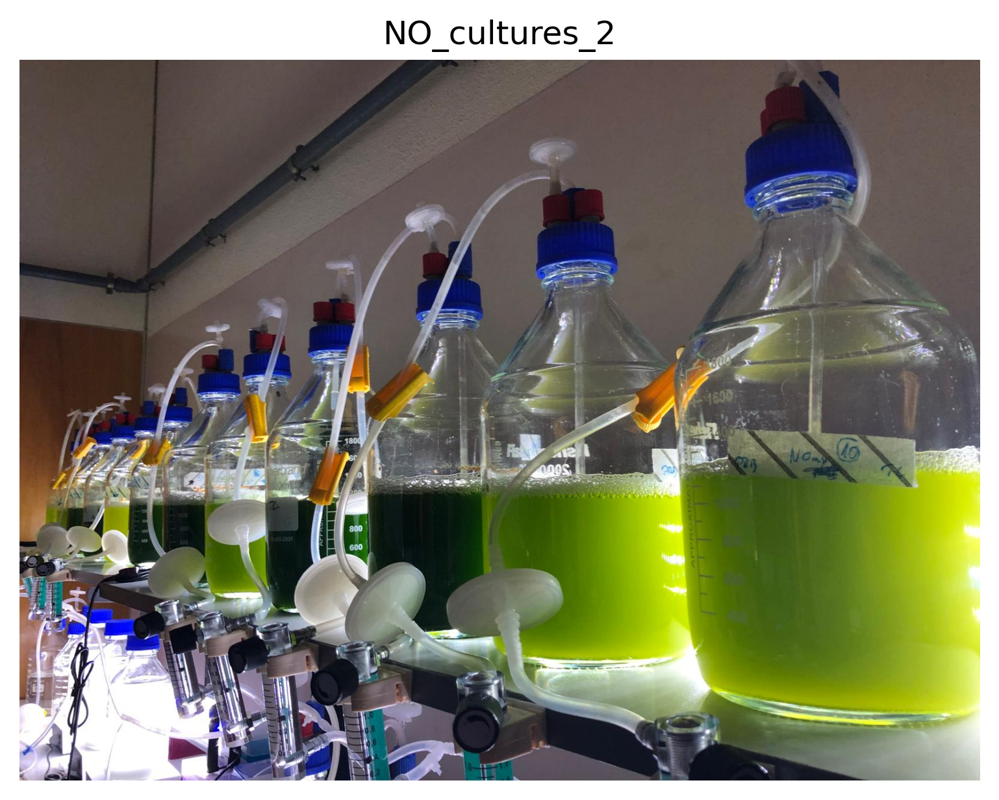

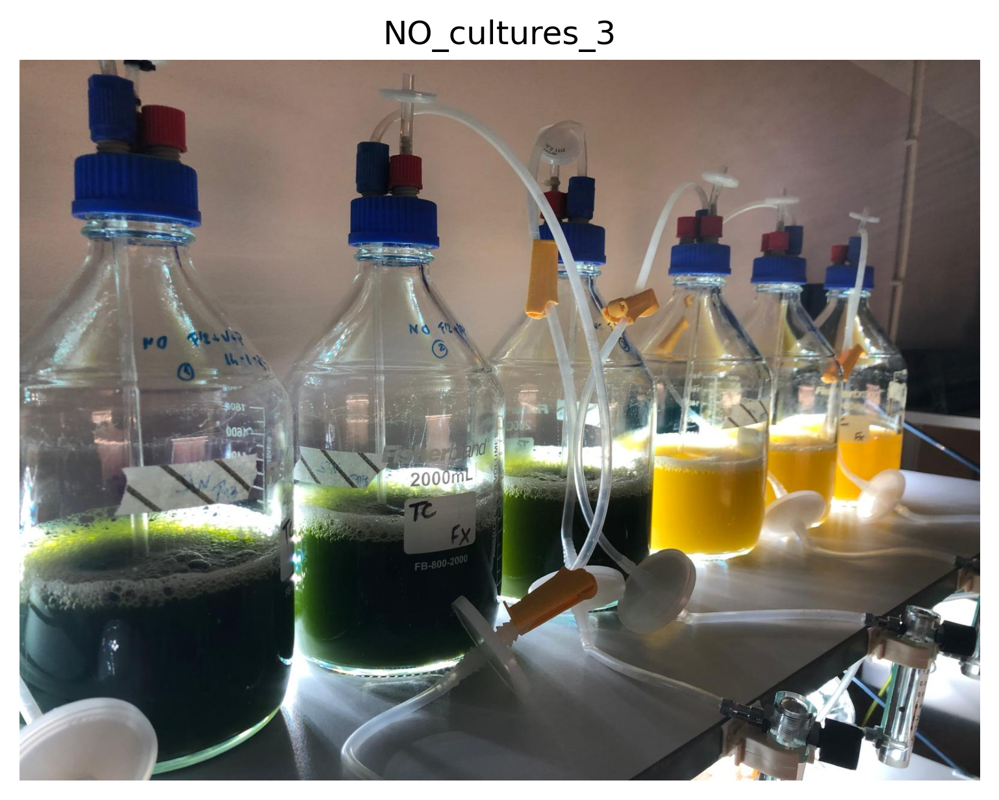

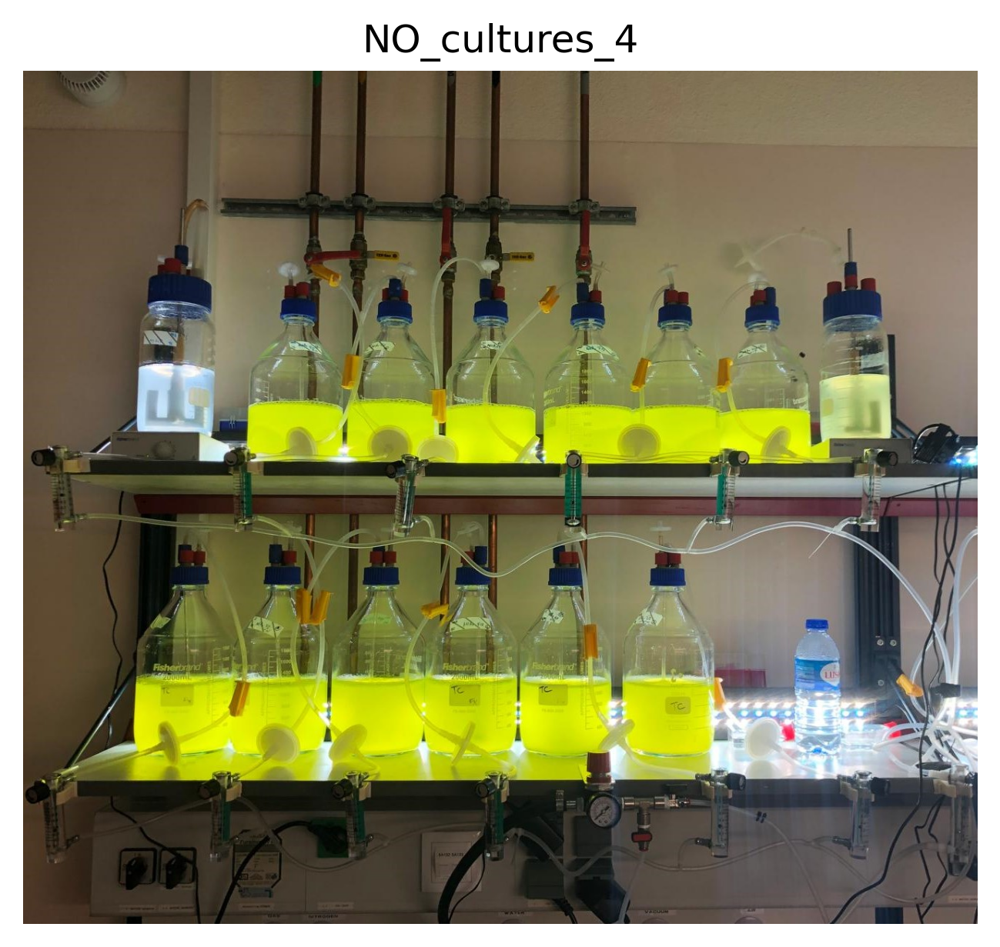

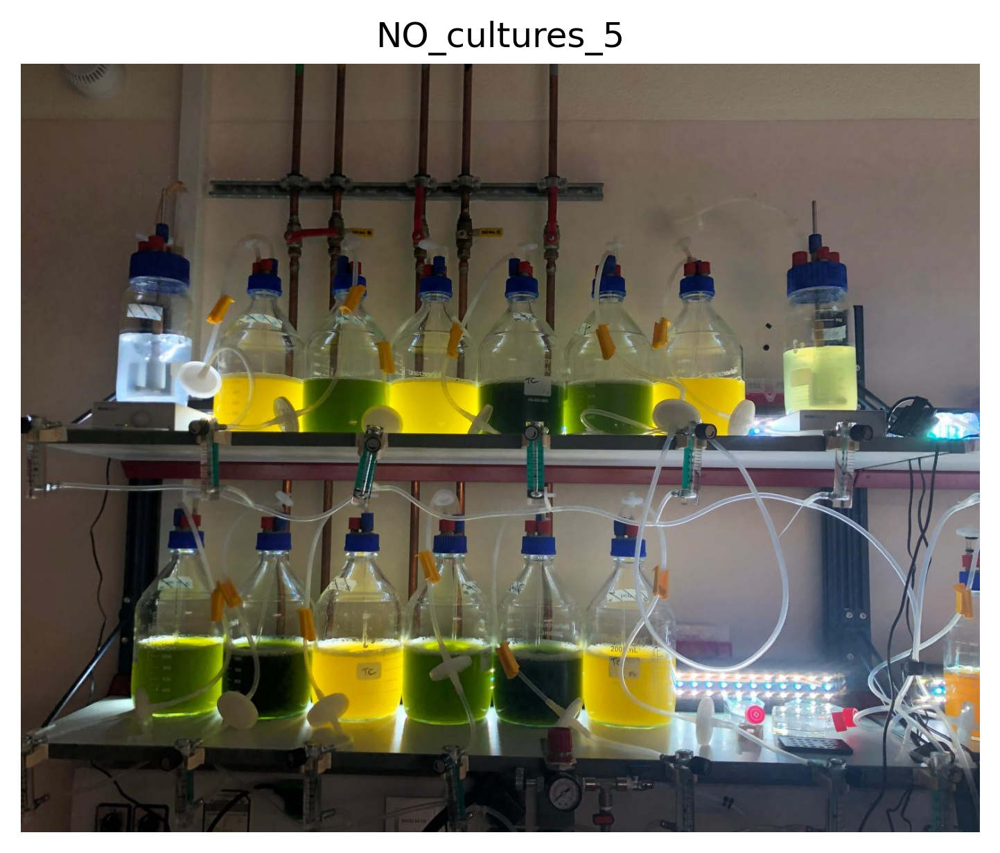

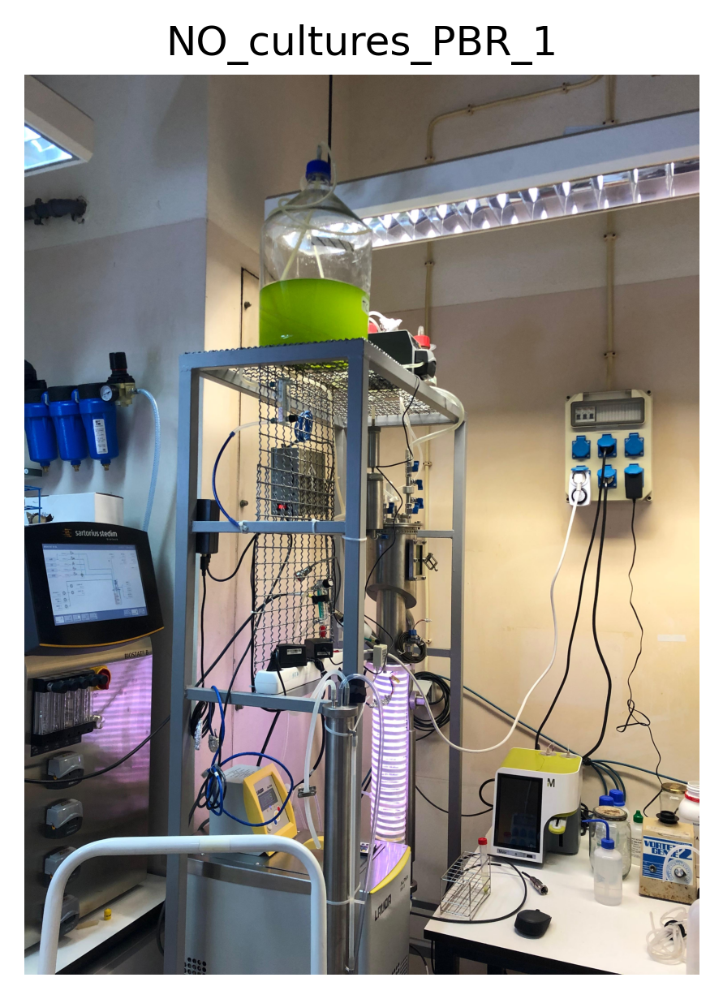

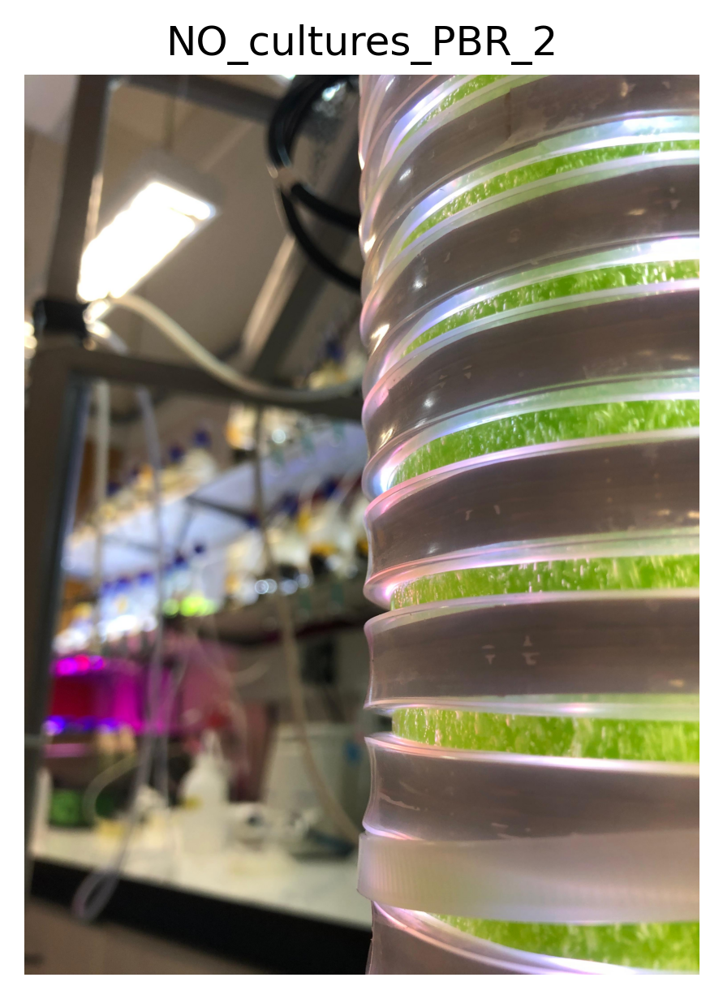

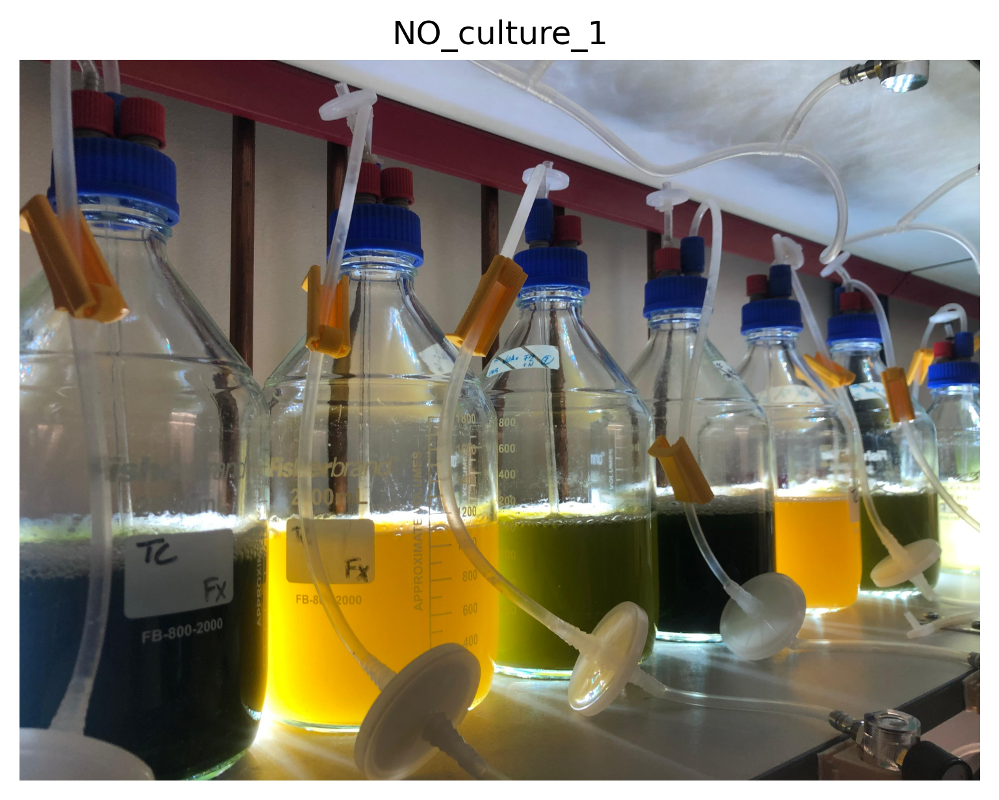

In [10]:
# Show pictures of the actual cultures

# Show some pictures from the actual cultures
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

folder = 'C:/Users/pedro.brandao/OneDrive - iBET/Desktop/Datasets and scripts updated/NO Dataset'

images = os.listdir(folder+'/Images')

for image in images:
    img = mpimg.imread(folder+'/Images/'+image)
    plt.imshow(img)
    plt.axis('off')
    plt.title(image[:-5])
    plt.show()

In this sense, we will plot again but with a color palette to
corresponde growth curves to the culture assays

We also added justpoint = True so only the means and standard deviations are,
included, simplifying the plot legend

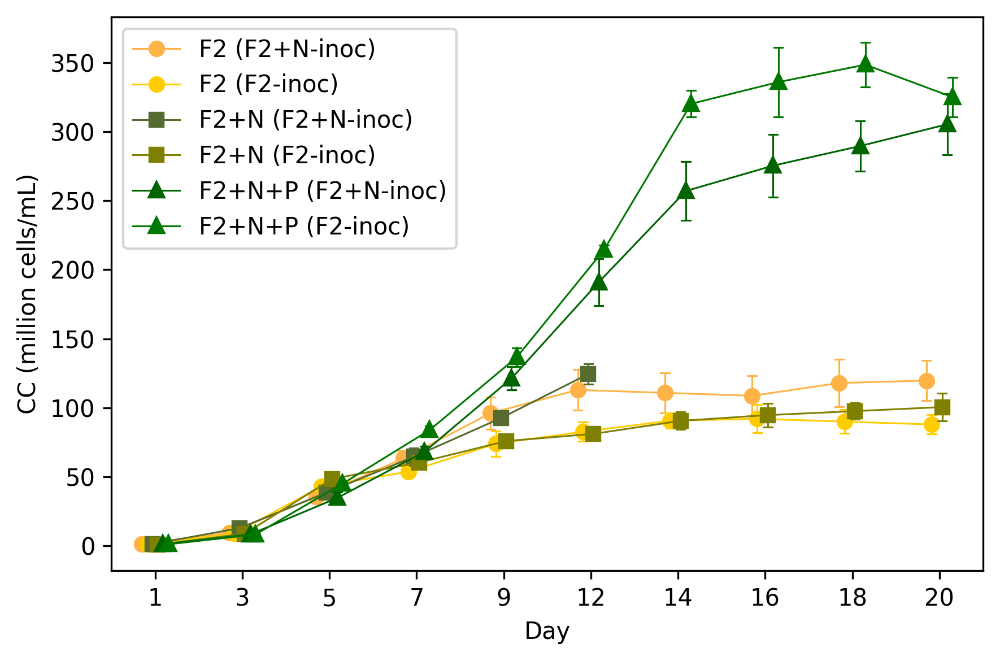

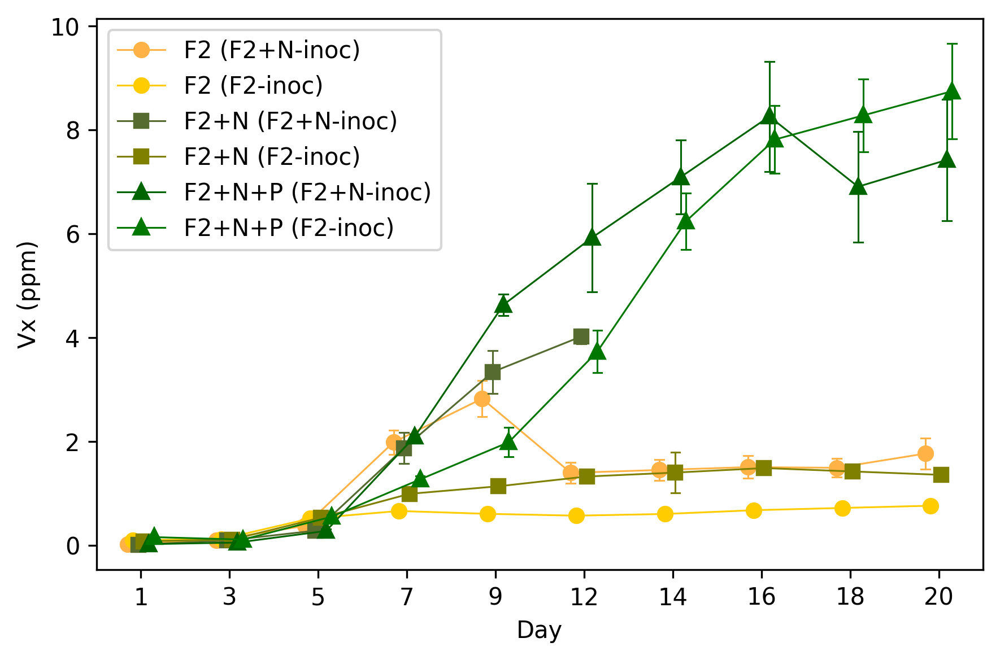

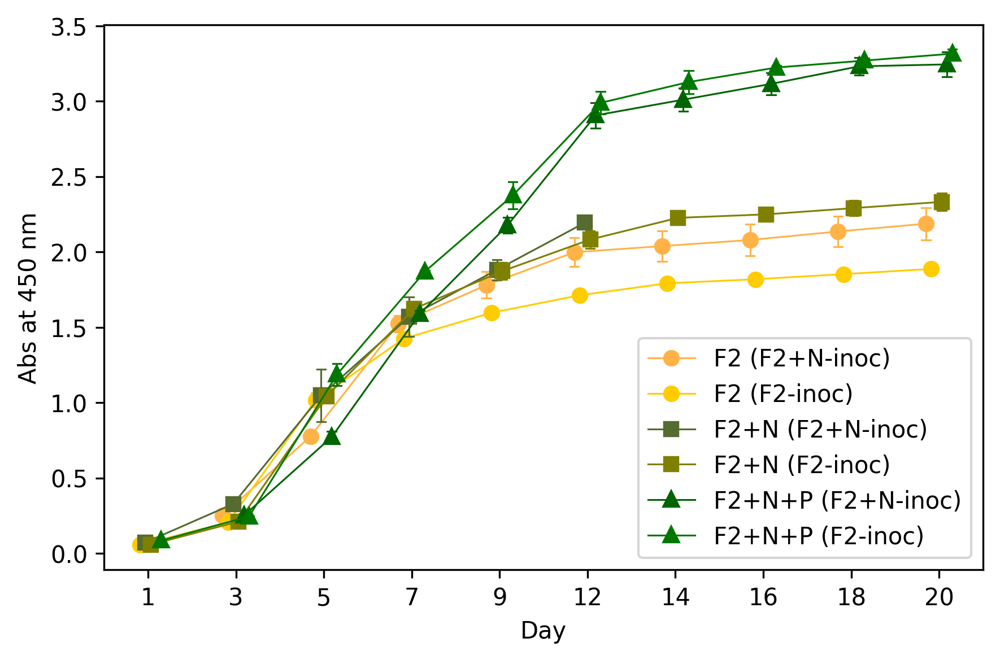

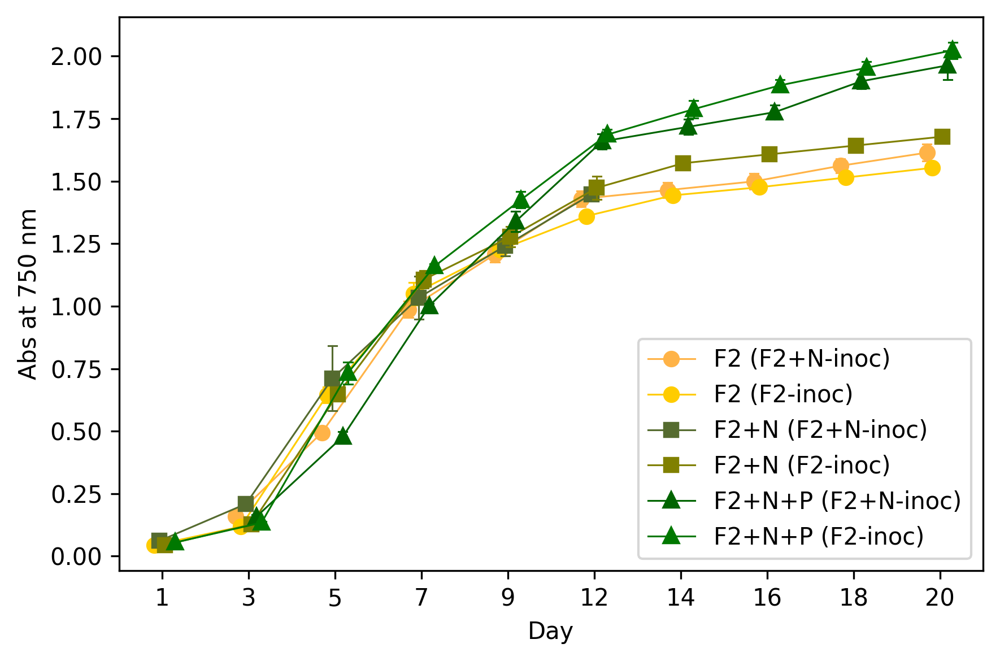

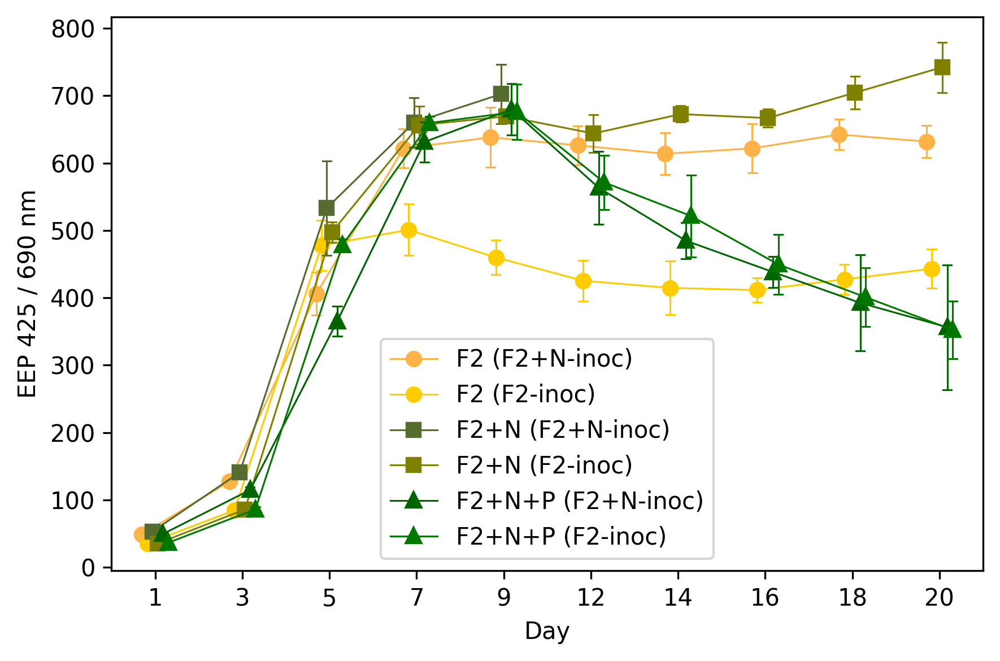

In [11]:
#%% Plot monitor parameters with custom colors for assay discrimination

# Define custom colors (in RGB, 0–255 scale)
colors = [
    (255, 179, 71),   # Yellowish Orange
    (255, 204, 0),    # Yellow-Orange
    (85, 107, 47),    # Dark Olive Green (Brownish Green)
    (128, 128, 0),    # Olive Green
    (0, 100, 0),      # Dark Green
    (0, 120, 0),      # Forest Green
]

# Plot each output with the custom colors
for output in parameters2plot:
    plot_output_timewise(
        monitordata2plot, 
        time, 
        output, 
        discrimination,
        colors=colors,
        figsize=(6, 4),
        legend=True,
        justpoint = True,
    )

Spectroscopy data is multivariate, so specialized
plots are required.

The following functions were made specifically for this purpose.

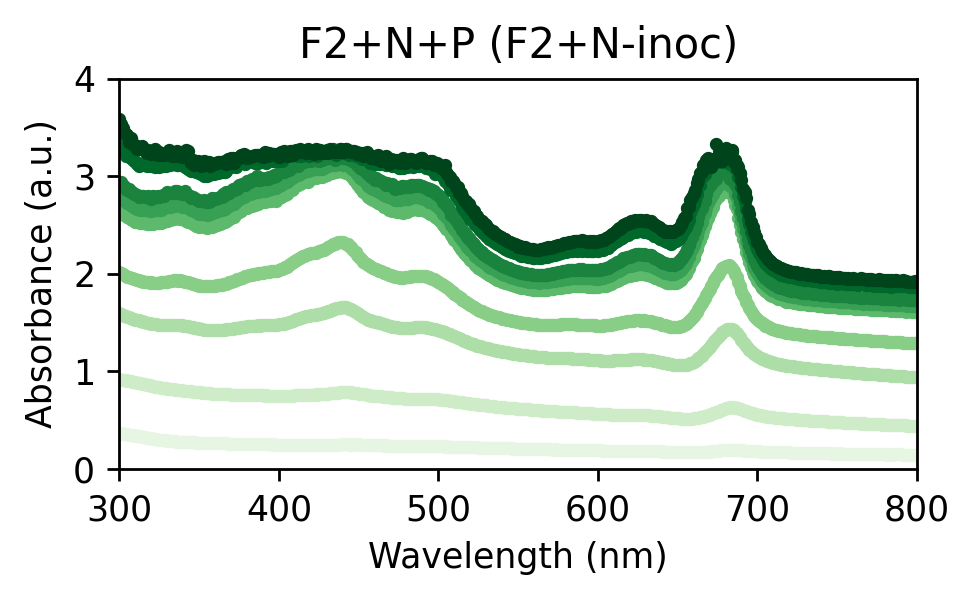

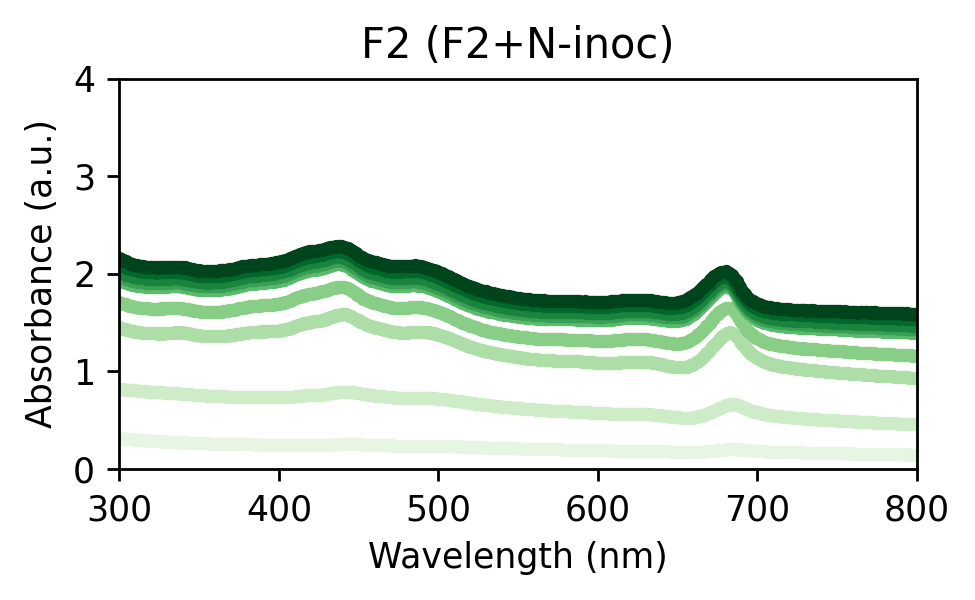

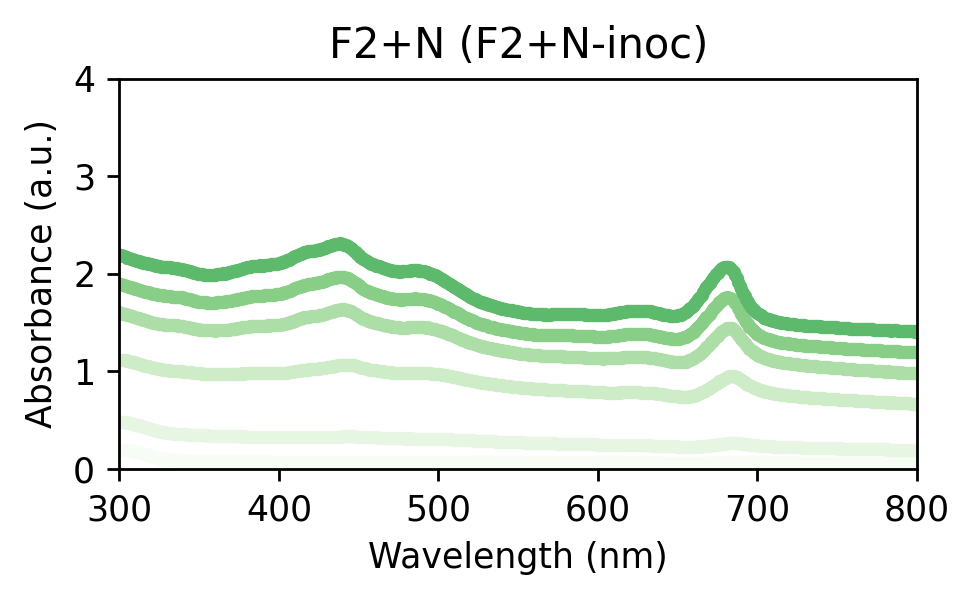

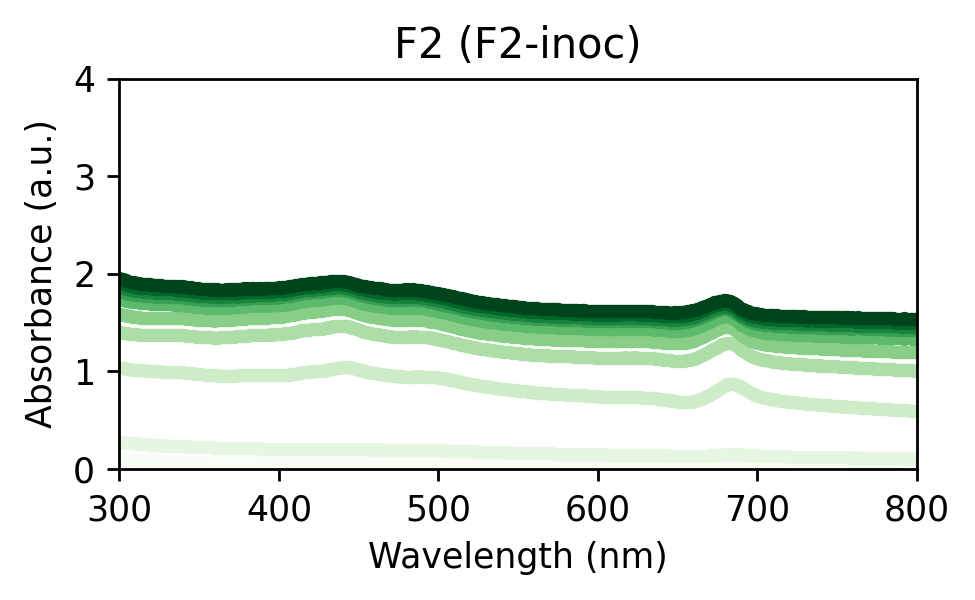

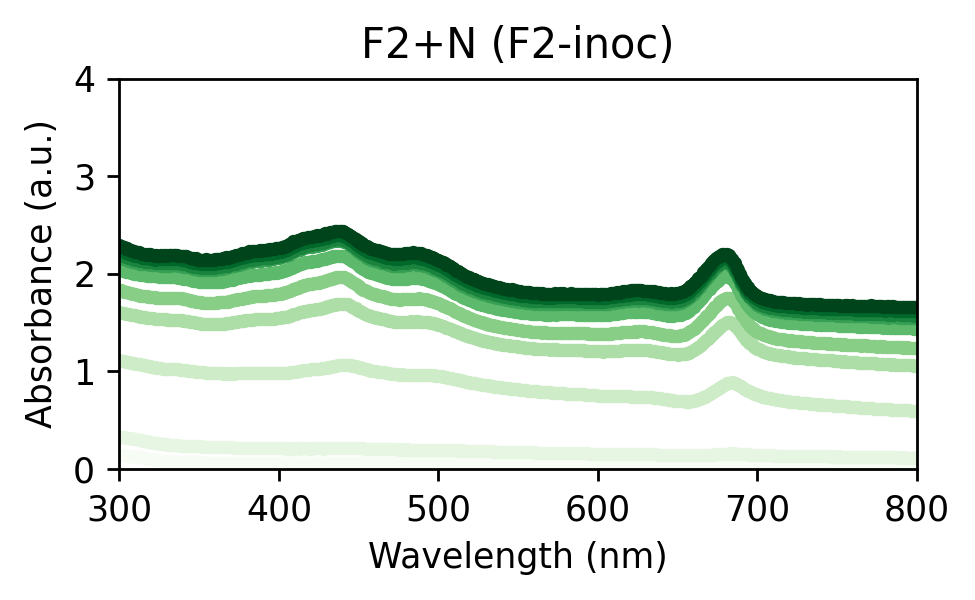

...

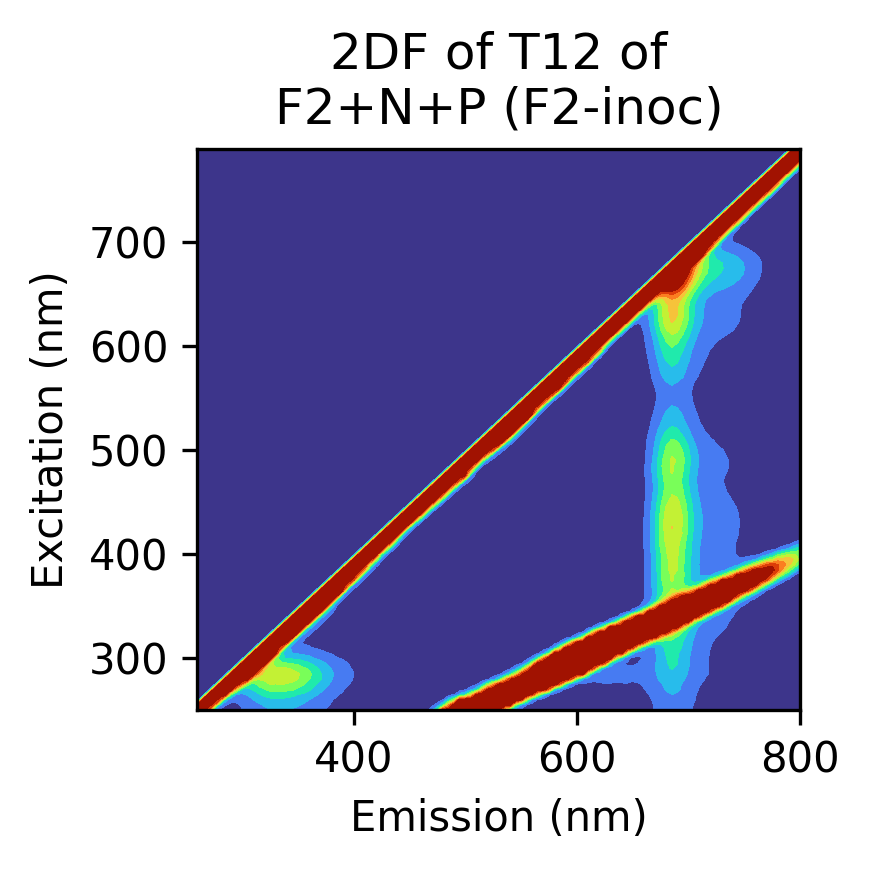

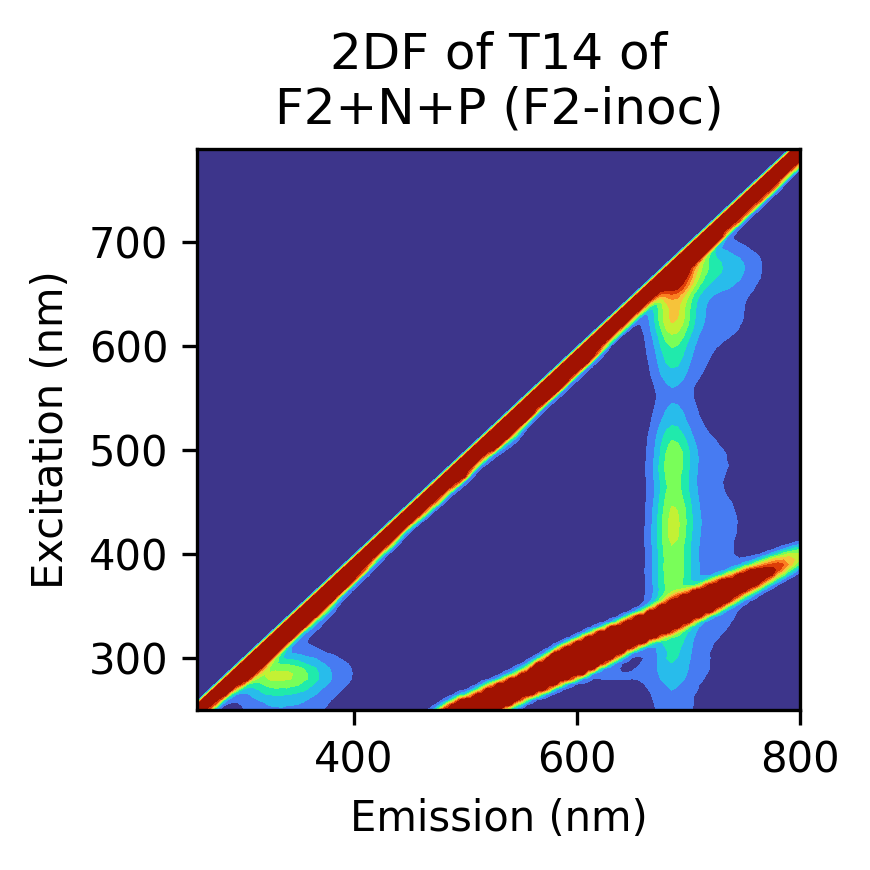

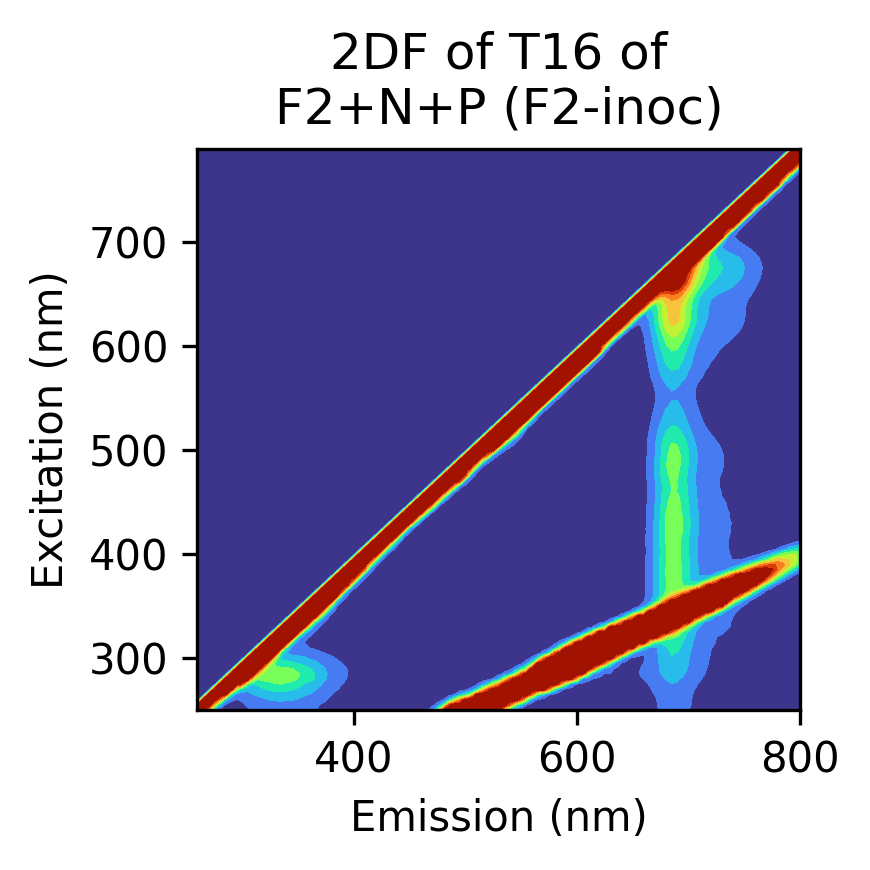

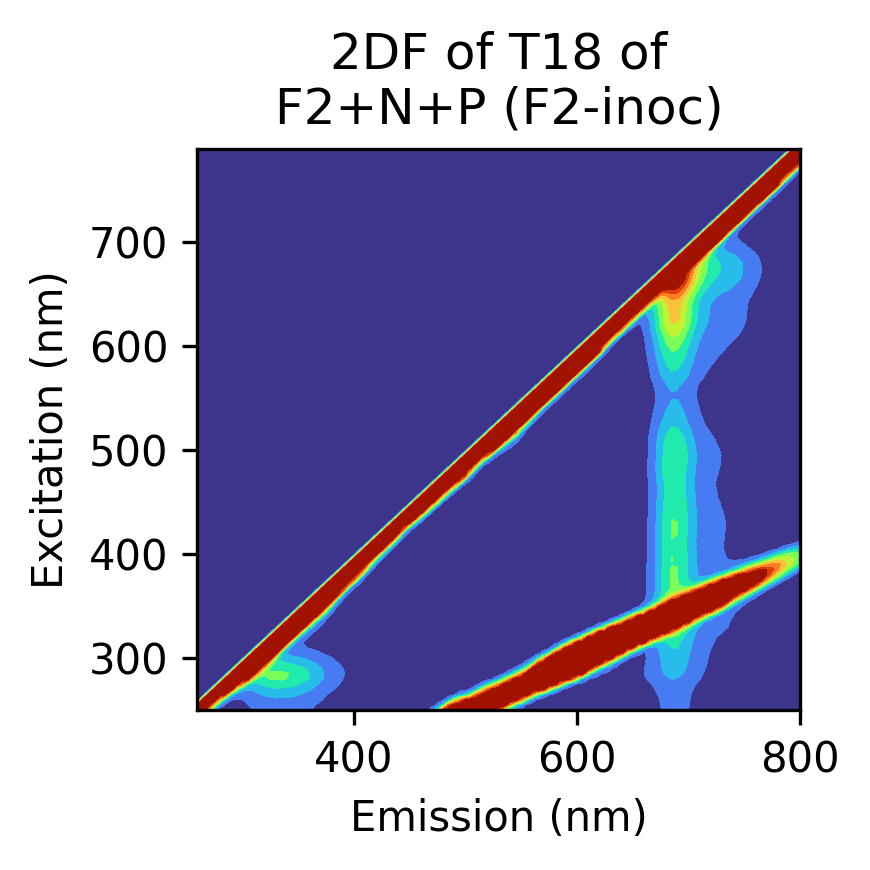

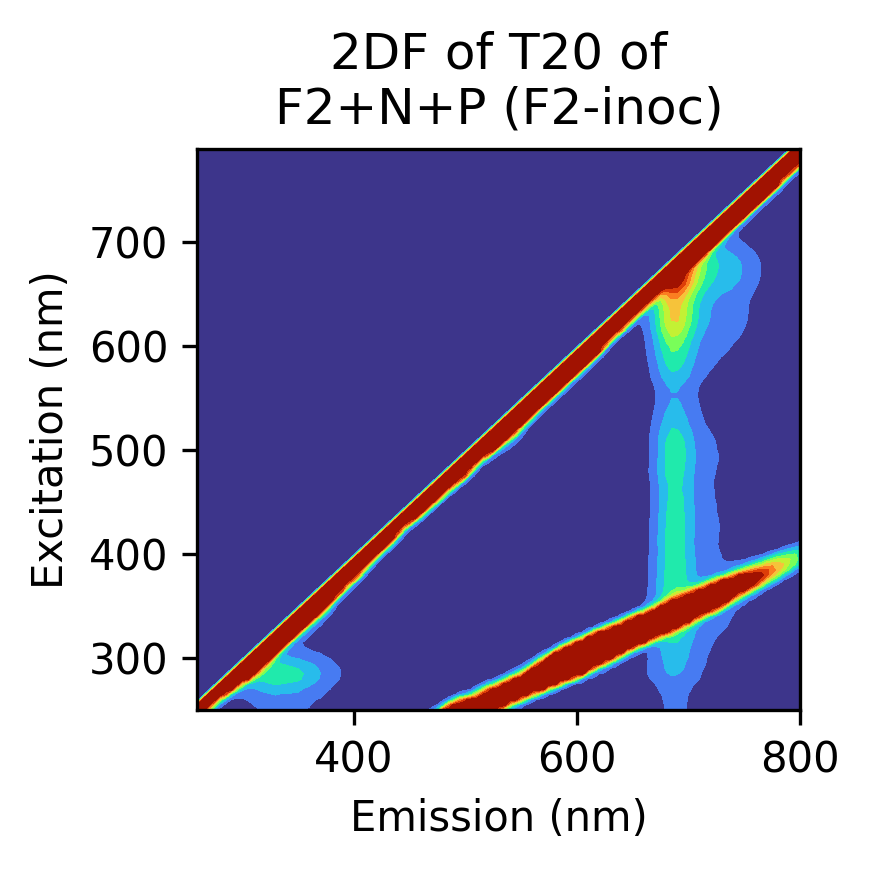

In [12]:
# Plot spectroscopy data

from spectrum_plotter import plotmeanAbsSpecs, plotmeanEEMs

# Define days to plot and list of assays
days = [1, 3, 5, 7, 9, 12, 14, 16, 18, 20]
assays = monitordata.index.get_level_values('Assay').unique()

# Plot mean absorbance spectra for each assay
plotmeanAbsSpecs(
    assays,
    discriminator='Assay',
    days2use=days,
    varxID=abswaves,
    df=absdata,
    ymax=4,
    dataindex=True,
    legend=False,             # Use boolean for clarity
    color_palette='Greens'
)

# Plot mean 2D fluorescence spectra (EEMs) for each assay
plotmeanEEMs(
    factors=assays,
    discriminator='Assay',
    plotdiffs=False,
    logtransf=False,
    days2use=days,
    varxID=fluorowaves,
    df=fluorodata,
    colorbar=False,
    dataindex=True,
    contours = False,
)

Previous spectral plots suggested different spectral
dynamics between assays. However, due to the multivariate
nature of the data, it’s hard to be certain by eye.

Unsupervised machine learning algorithms help find patterns
in multivariate data without supervision.

Principal Component Analysis (PCA) is one of them, a powerful
technique for exploratory analysis of such data. It compresses the data
according to directions of greatest variance.

We will use PCA to project our spectral observations into 2D
("Score Plot"). Each point represents a spectrum from a sample.


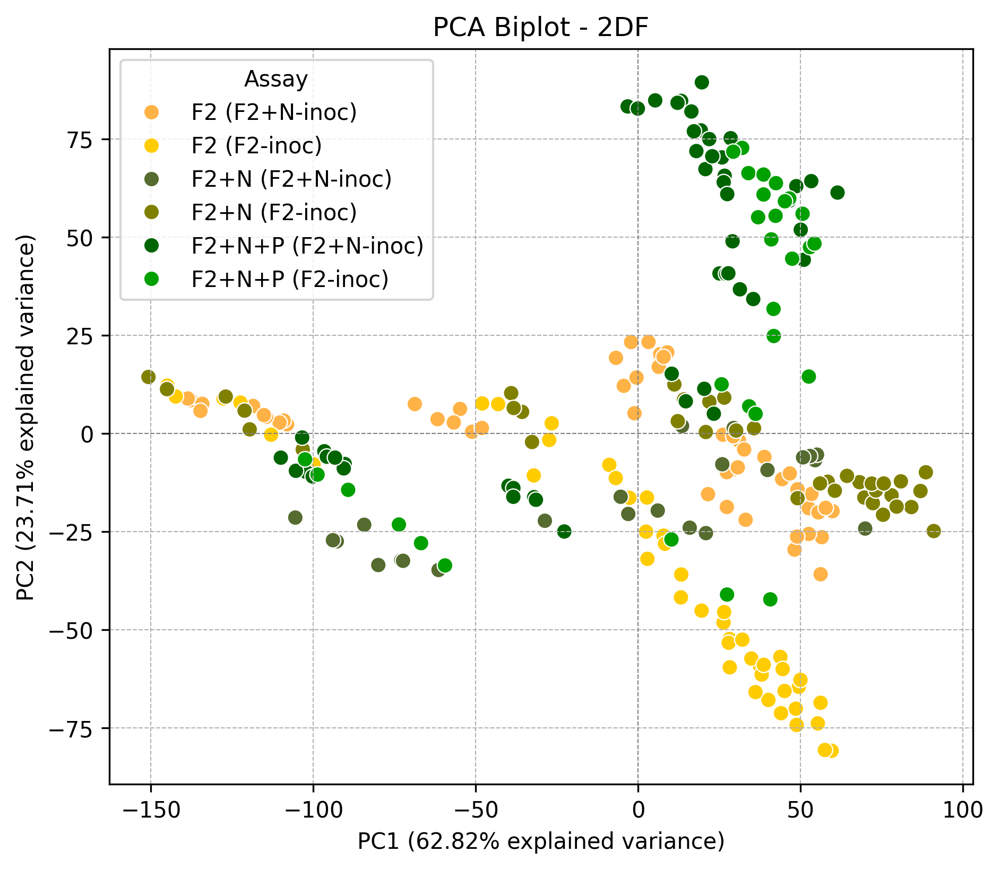

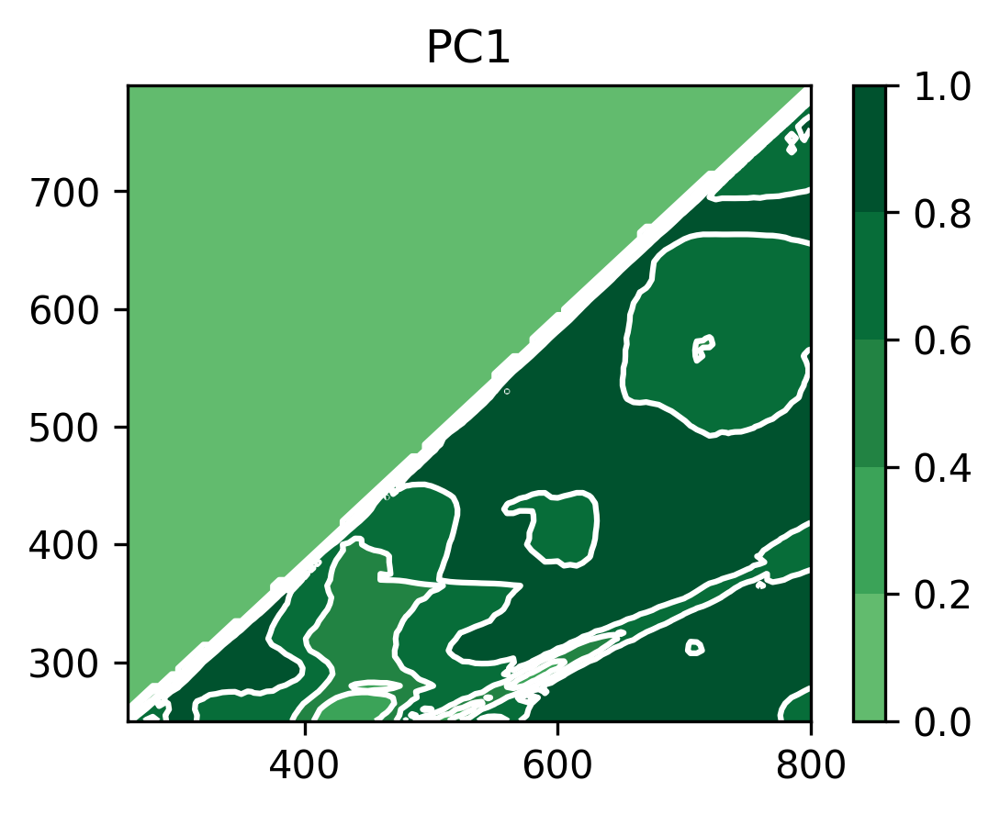

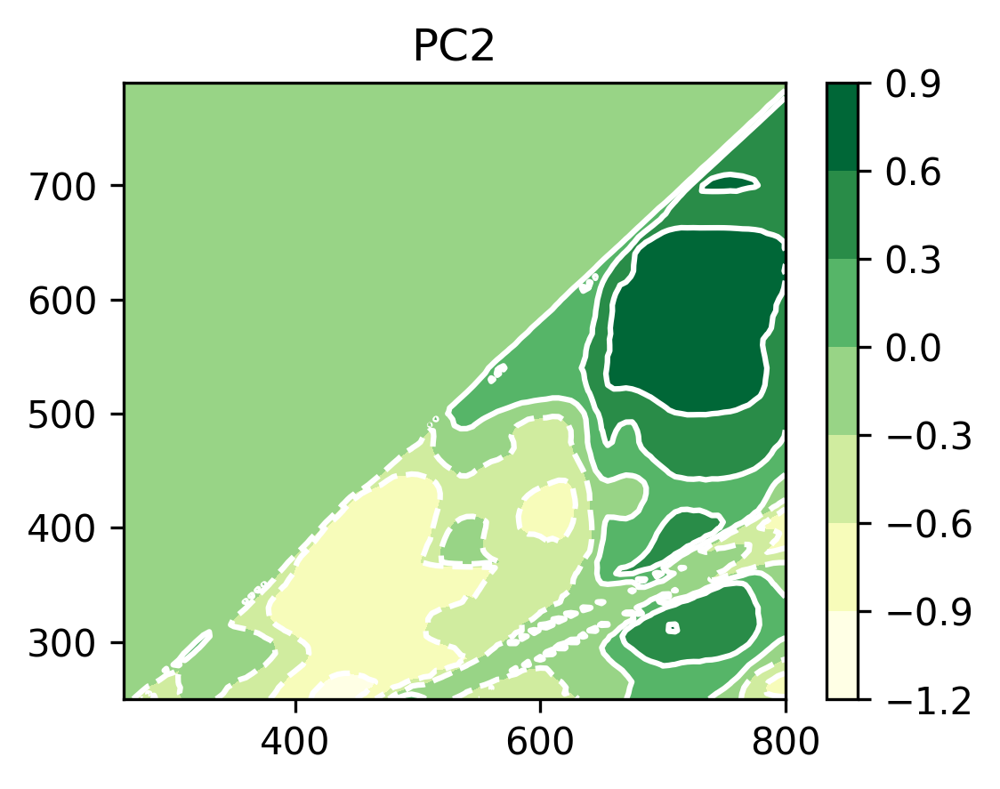

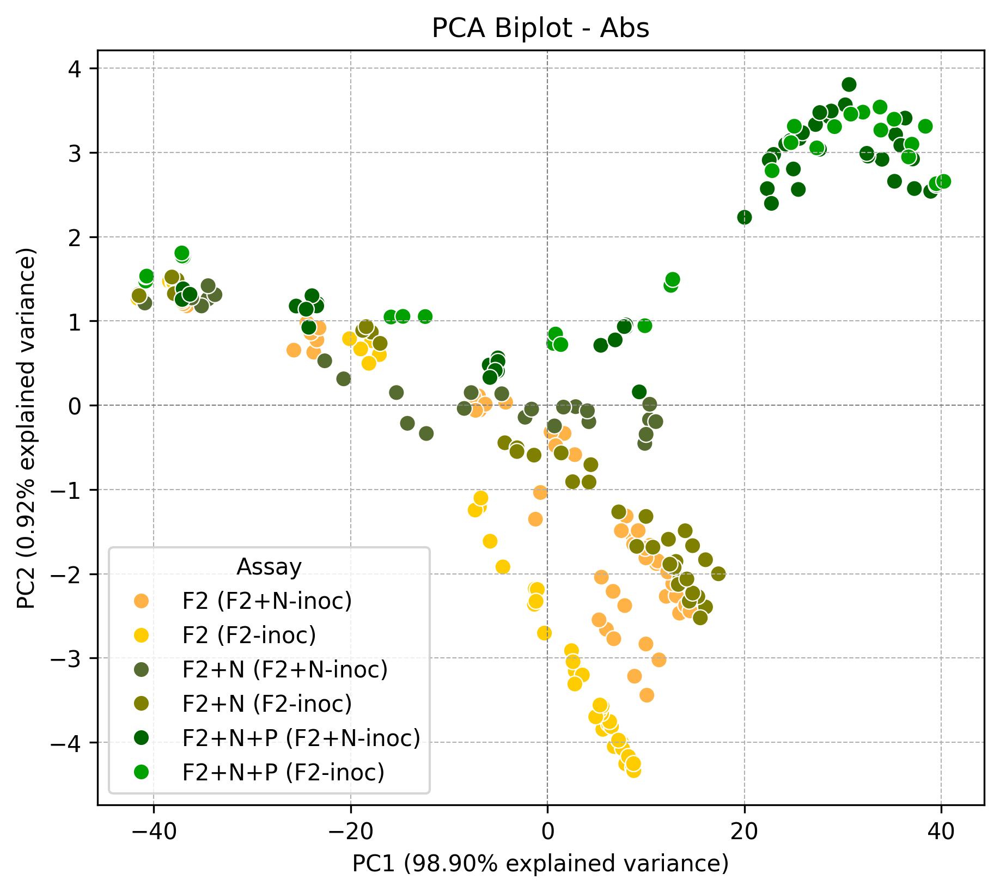

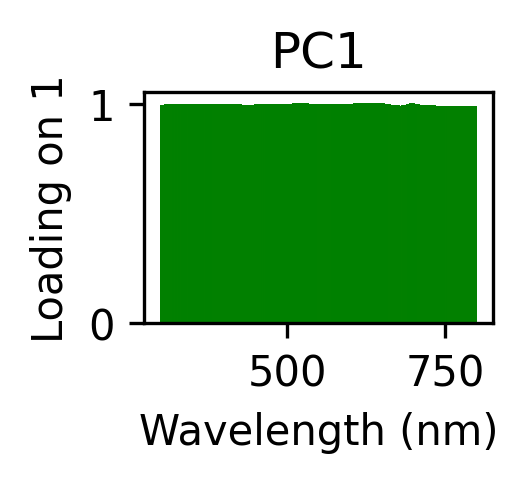

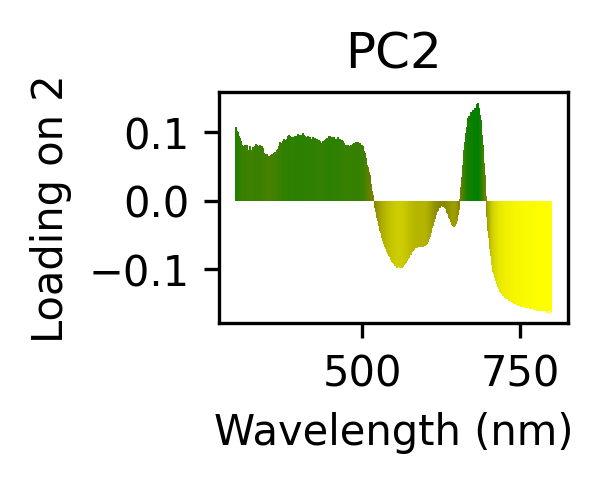

In [12]:
# Unsupervised machine learning: Are there spectral patterns?

# Define custom colors (as RGB tuples)
colors = [
    (255, 179, 71),   # Yellowish Orange
    (255, 204, 0),    # Yellow-Orange
    (85, 107, 47),    # Dark Olive Green (Brownish Green)
    (128, 128, 0),    # Olive Green
    (0, 100, 0),      # Dark Green
    (0, 160, 0),      # Forest Green
]

from PCA_function import process_pca

# PCA on 2D fluorescence spectra
pca_2df = process_pca(
    data='2DF',
    data2use_group='Assay',
    data2use=[
        'F2 (F2-inoc)', 'F2+N (F2-inoc)', 'F2+N+P (F2-inoc)',
        'F2 (F2+N-inoc)', 'F2+N (F2+N-inoc)', 'F2+N+P (F2+N-inoc)'
    ],
    days2include=[1, 3, 5, 7, 9, 12, 14, 16, 18, 20],
    discrimination='Assay',
    fluorodata=fluorodata,
    colors=colors,
    rgb_colors=True,
    legend=True,
    show_spectral_heatmaps=True,
    cmap4spectra='YlGn',
    negatePC2=True
)

# PCA on absorbance spectra
pca_abs = process_pca(
    data='Abs',
    data2use_group='Assay',
    data2use=[
        'F2 (F2-inoc)', 'F2+N (F2-inoc)', 'F2+N+P (F2-inoc)',
        'F2 (F2+N-inoc)', 'F2+N (F2+N-inoc)', 'F2+N+P (F2+N-inoc)'
    ],
    days2include=[1, 3, 5, 7, 9, 12, 14, 16, 18, 20],
    discrimination='Assay',
    absdata=absdata,
    colors=colors,
    rgb_colors=True,
    legend=True,
    show_spectral_heatmaps=True,
    cmap4spectra='YlGn',
    negatePC2=True
)

We may color the points according to the parameters of monitoring interest

This way, we may already see if the two major directions of variance of the
spectroscopy data correlate with the quantity of the parameters of interest

For example, hot tones, where the hotter the color of a point the higher
its value of Vx (violaxanthin, ppm) or CytoNR (average single-cell lipid
content measured by Nile Red method, yellow fluorescence a.u.)

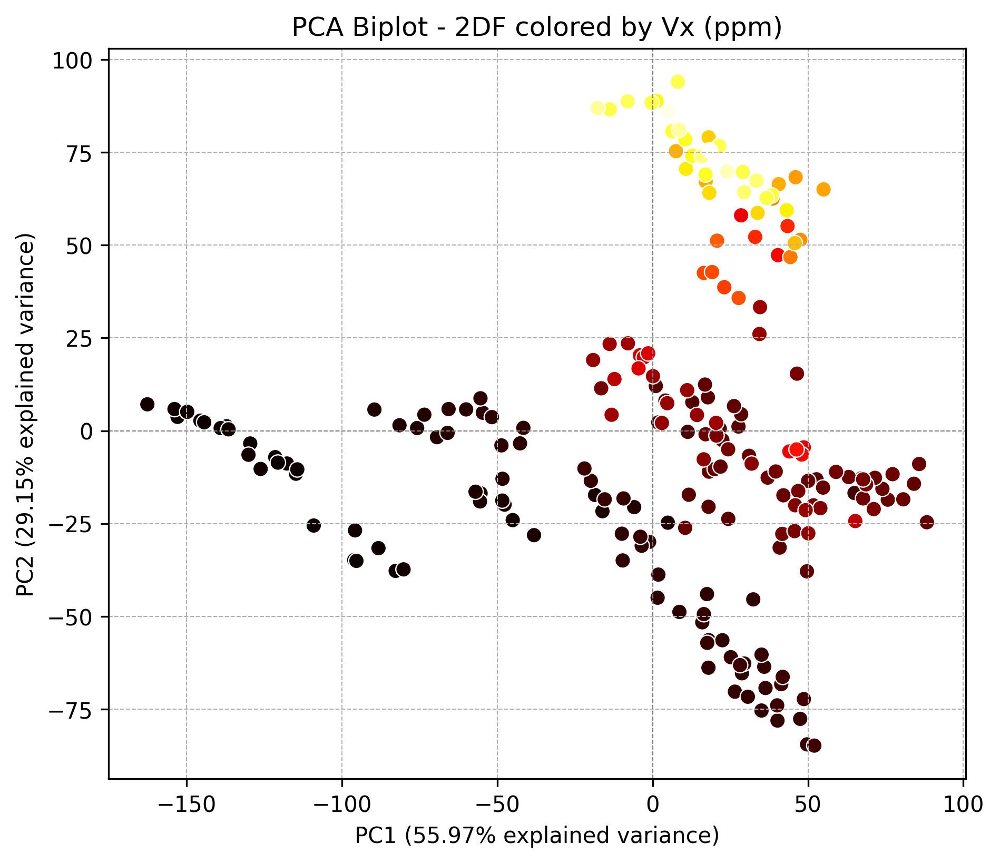

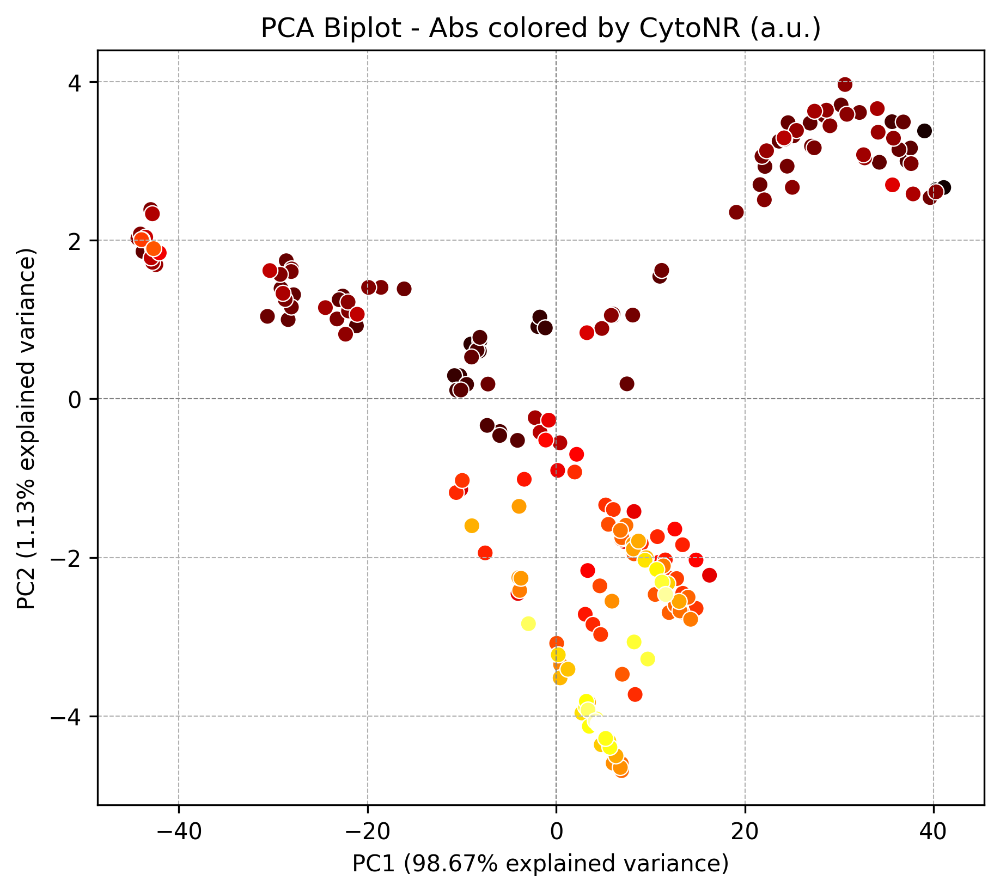

In [13]:
# Color PCA scores according to parameter of monitor interest or time


data = '2DF'

output_of_interest = 'Vx (ppm)'

pca= process_pca(
    data=data,
    data2use_group = 'Assay',
    data2use= ['F2 (F2-inoc)','F2+N (F2-inoc)','F2+N+P (F2-inoc)',
              'F2 (F2+N-inoc)','F2+N (F2+N-inoc)','F2+N+P (F2+N-inoc)',
              ],
    days2include=[3,5,7,9,12,14,16,18,20],
    discrimination = output_of_interest,
    fluorodata=fluorodata,
    monitordata = monitordata,
    personalized_discrimination= True,
    colors = 'hot', #colors,

    legend = 0,
    negatePC2 = True
    )

data = 'Abs'

output_of_interest = 'CytoNR (a.u.)'

pca= process_pca(
    data=data,
    data2use_group = 'Assay',
    data2use= ['F2 (F2-inoc)','F2+N (F2-inoc)','F2+N+P (F2-inoc)',
              'F2 (F2+N-inoc)','F2+N (F2+N-inoc)','F2+N+P (F2+N-inoc)',
              ],
    days2include=[3,5,7,9,12,14,16,18,20],
    discrimination = output_of_interest,
    absdata = absdata,
    monitordata = monitordata,
    personalized_discrimination= True,
    colors = 'hot', #colors,

    legend = 0,
    negatePC2 = True
    )

We can already see a clear correlation between inputs and outputs, without
any supervised machine learning.

We may now move to supervised machine learning algorithms (e.g., regression
classification), so we get models that predict the outputs (monitor parameters)
from inputs (spectra)